In [1]:
!pip install -Uqq transformers accelerate diffusers fastcore

In [2]:
import logging
from pathlib import Path

import matplotlib.pyplot as plt
import torch
from fastcore.all import *
from huggingface_hub import notebook_login
from PIL import Image, ImageOps

logging.disable(logging.WARNING)

torch.manual_seed(1)
if not (Path.home()/'.huggingface'/'token').exists(): notebook_login()

In [3]:
from tqdm.auto import tqdm

In [4]:
import numpy as np
np.set_printoptions(precision=2, linewidth=140)     
torch.set_printoptions(precision=2, linewidth=140, sci_mode=False)

In [5]:
from transformers import CLIPTextModel, CLIPTokenizer
from diffusers import AutoencoderKL, UNet2DConditionModel
from diffusers import LMSDiscreteScheduler

In [6]:
from PIL import Image, ImageOps

def image_grid(imgs, rows, cols, border=False, border_size=5, border_color=(255, 102, 0)):
    if border: imgs = [ImageOps.expand(img, border=border_size, fill=border_color) for img in imgs]    
    w,h = imgs[0].size
    grid = Image.new('RGB', size=(cols*w, rows*h))
    for i, img in enumerate(imgs): grid.paste(img, box=(i%cols*w, i//cols*h))
    return grid

In [7]:
# params
height = 512
width = 512
num_inference_steps = 70
guidance_scale = 7.5
batch_size = 1
beta_start,beta_end = 0.00085,0.012

In [8]:
# stuff to process input
tokenizer = CLIPTokenizer.from_pretrained("openai/clip-vit-large-patch14", torch_dtype=torch.float16)
text_encoder = CLIPTextModel.from_pretrained("openai/clip-vit-large-patch14", torch_dtype=torch.float16).to("cuda")

# stuff to run denoising
unet = UNet2DConditionModel.from_pretrained("CompVis/stable-diffusion-v1-4", subfolder="unet", torch_dtype=torch.float16).to("cuda")
scheduler = LMSDiscreteScheduler(beta_start=beta_start, beta_end=beta_end, beta_schedule="scaled_linear", num_train_timesteps=1000)

# stuff to turn latent into image
vae = AutoencoderKL.from_pretrained("stabilityai/sd-vae-ft-ema", torch_dtype=torch.float16).to("cuda")

In [9]:
def text_enc(prompts, maxlen=None):
    if maxlen is None: maxlen = tokenizer.model_max_length
    inp = tokenizer(prompts, padding="max_length", max_length=maxlen, truncation=True, return_tensors="pt")
    return text_encoder(inp.input_ids.to("cuda"))[0].half()

def mk_img(t):
    image = (t/2+0.5).clamp(0,1).detach().cpu().permute(1, 2, 0).numpy()
    return Image.fromarray((image*255).round().astype("uint8"))

In [10]:
from IPython.display import display
def display_images(img_samples, grid=False, cols=None, border=False, border_size=5, border_color=(255, 102, 0)):
    if not isinstance(img_samples, list) and len(img_samples.shape)==3: img_samples = [img_samples]  # if single image, turn into list
    imgs = list(map(mk_img, img_samples))
    
    if grid:
        rows=math.ceil(len(img_samples)/cols)
        display(image_grid(imgs, cols=cols, rows=rows, border=border, border_size=border_size, border_color=border_color))
    else:
        for img in imgs: display(img)

## Negative prompts

In [11]:
prompt = "a child's drawing of the Eiffel tower"
negative_prompt = "black"

[...]

Idea 2 (from forums): Subtract in space of "noise deficits" (ie after unet)

In [12]:
images = []

def clear_images_cb(latents):
    global images
    images = []
    print('Images cleared')

def save_initial_image_cb(latents):
    global images
    img = vae.decode(1 / 0.18215 * latents).sample[0].cpu().detach()
    images.append(img)
    
def save_image_cb(i,ts,latents):
    global images
    img = vae.decode(1 / 0.18215 * latents).sample[0].cpu().detach()
    images.append(img)
    
def print_shapes_and_latents(i,ts,latents):
    print(f"Step {i}, ts = {ts:.2f} | latents: shape={latents.shape}, data={latents[0,:2,:2,:2].flatten().cpu().numpy()}...")

In [13]:
def mk_samples(prompts, negative_prompts=None, g=7.5, seed=100, steps=70, cbs=[], cbs_init=[]):
    if negative_prompts: assert len(prompts) == len(negative_prompts)
    
    bs = len(prompts)
    text = text_enc(prompts)
    uncond = text_enc([""] * bs, text.shape[1])
    if negative_prompts: text_neg = text_enc(negative_prompts, text.shape[1])  # Q: Why do we set the max_length to text.shape[1]
    emb = torch.cat([uncond, text, text_neg]) if negative_prompts else torch.cat([uncond, text])
    if seed: torch.manual_seed(seed)

    n_emb = len(emb)
        
    latents = torch.randn((bs, unet.in_channels, height//8, width//8))
    scheduler.set_timesteps(steps)
    latents = latents.to("cuda").half() * scheduler.init_noise_sigma

    for cb in cbs_init: cb(latents)
    
    for i,ts in enumerate(tqdm(scheduler.timesteps)):        
        inp = scheduler.scale_model_input(torch.cat([latents] * n_emb), ts)
        with torch.no_grad():
            if negative_prompts: u,t,tn = unet(inp, ts, encoder_hidden_states=emb).sample.chunk(n_emb)
            else: u,t = unet(inp, ts, encoder_hidden_states=emb).sample.chunk(n_emb)
                
        if negative_prompts: pred = u + g*(t-u-tn)
        else: pred = u + g*(t-u)

        latents = scheduler.step(pred, ts, latents).prev_sample
        
        for cb in cbs: cb(i,ts,latents)

    with torch.no_grad(): return vae.decode(1 / 0.18215 * latents).sample

In [14]:
samples = mk_samples([prompt], [negative_prompt])

/tmp/ipykernel_158/3603111561.py:13: FutureWarning: Accessing config attribute `in_channels` directly via 'UNet2DConditionModel' object attribute is deprecated. Please access 'in_channels' over 'UNet2DConditionModel's config object instead, e.g. 'unet.config.in_channels'.
  latents = torch.randn((bs, unet.in_channels, height//8, width//8))


  0%|          | 0/70 [00:00<?, ?it/s]

/tmp/ipykernel_158/2728834448.py:8: RuntimeWarning: invalid value encountered in cast
  return Image.fromarray((image*255).round().astype("uint8"))


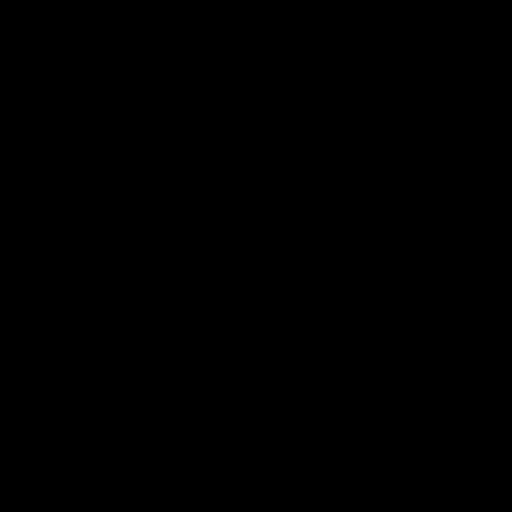

In [15]:
display_images(samples)

In notebook on Kaggle I verified:
- same seed implies same initial random latents, there's no other source of randomness (except numerical instability)
- the initial noise is scaled by the scheduler

[...]

The inial image is okay. Now, we need to check if transitions are okay. Because changes can be hard to spot, let's use more than 2 steps.

In [16]:
img_samples = mk_samples([prompt], [negative_prompt], cbs=[save_image_cb], cbs_init=[clear_images_cb, save_initial_image_cb], steps=10)

Images cleared


/tmp/ipykernel_158/3603111561.py:13: FutureWarning: Accessing config attribute `in_channels` directly via 'UNet2DConditionModel' object attribute is deprecated. Please access 'in_channels' over 'UNet2DConditionModel's config object instead, e.g. 'unet.config.in_channels'.
  latents = torch.randn((bs, unet.in_channels, height//8, width//8))


  0%|          | 0/10 [00:00<?, ?it/s]

`display_images(images, grid=True, cols=5)` fails as `clamp` (used in `mk_img`) is not implemented for cpu data types. So let's adjust `mk_img` to move data to GPU if necessary

In [17]:
def mk_img(t):
    try:
        image = (t/2+0.5).clamp(0,1).detach().cpu().permute(1, 2, 0).numpy()
    except RuntimeError as e:
        image = (t.cuda()/2+0.5).clamp(0,1).detach().cpu().permute(1, 2, 0).numpy()    
    return Image.fromarray((image*255).round().astype("uint8"))

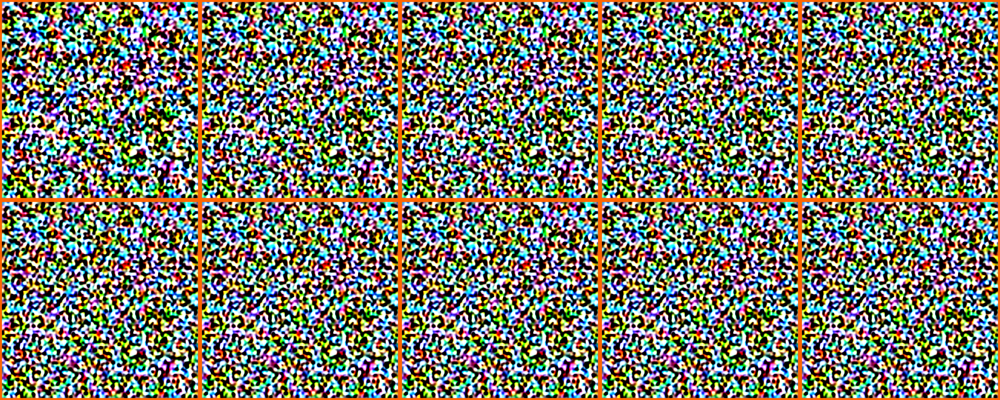

In [19]:
display_images(images[1:], grid=True, cols=5, border=True)

In [20]:
for i, im in enumerate(images):
    print(f'Image {i}: {im[:2,:2,:2].flatten()}')

Image 0: tensor([ 0.01,  0.00,  0.07, -0.01,  0.19,  0.25,  0.29,  0.35], dtype=torch.float16)
Image 1: tensor([-0.03, -0.06, -0.01, -0.11,  0.16,  0.21,  0.25,  0.31], dtype=torch.float16)
Image 2: tensor([-0.05, -0.08, -0.04, -0.14,  0.13,  0.18,  0.21,  0.26], dtype=torch.float16)
Image 3: tensor([-0.06, -0.09, -0.05, -0.15,  0.13,  0.17,  0.20,  0.24], dtype=torch.float16)
Image 4: tensor([-0.06, -0.09, -0.05, -0.15,  0.12,  0.16,  0.19,  0.24], dtype=torch.float16)
Image 5: tensor([-0.06, -0.09, -0.05, -0.16,  0.12,  0.16,  0.19,  0.23], dtype=torch.float16)
Image 6: tensor([-0.06, -0.09, -0.06, -0.16,  0.12,  0.15,  0.18,  0.23], dtype=torch.float16)
Image 7: tensor([-0.06, -0.09, -0.06, -0.16,  0.12,  0.15,  0.18,  0.23], dtype=torch.float16)
Image 8: tensor([-0.06, -0.10, -0.06, -0.16,  0.12,  0.15,  0.18,  0.22], dtype=torch.float16)
Image 9: tensor([-0.06, -0.10, -0.06, -0.16,  0.11,  0.15,  0.18,  0.22], dtype=torch.float16)
Image 10: tensor([-0.06, -0.10, -0.06, -0.16,  0.1

Looking at the numbers, The samples seems to change each step; but the images seem to stay the same. So let's test if `display_images` works as intended

In [63]:
different_ims = [(torch.ones_like(images[0]) * scale) for scale in range(0,255,25)]

In [64]:
for i in range(3): print(different_ims[i][:2,:2,:2].flatten(), different_ims[i].shape)

tensor([0., 0., 0., 0., 0., 0., 0., 0.], dtype=torch.float16) torch.Size([3, 512, 512])
tensor([25., 25., 25., 25., 25., 25., 25., 25.], dtype=torch.float16) torch.Size([3, 512, 512])
tensor([50., 50., 50., 50., 50., 50., 50., 50.], dtype=torch.float16) torch.Size([3, 512, 512])


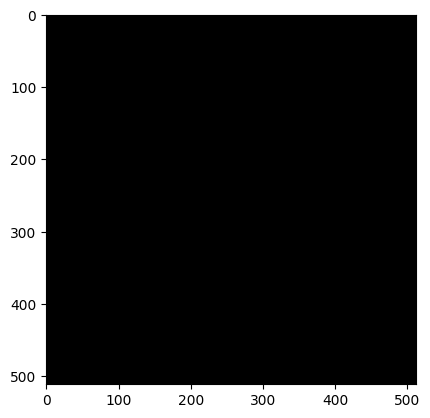

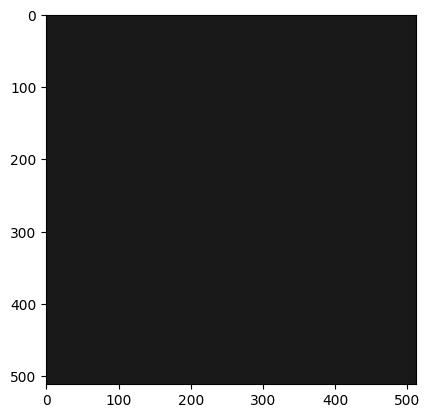

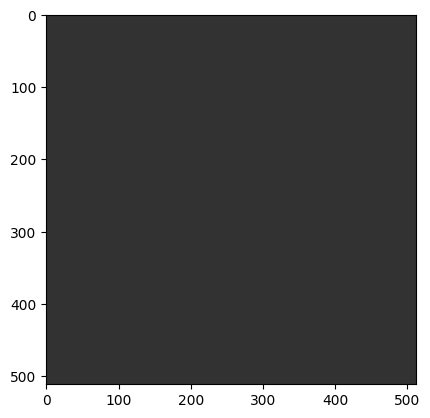

In [66]:
for i in range(3):
    plt.imshow(Image.fromarray(different_ims[i].permute(1, 2, 0).numpy().astype("uint8")))
    plt.show()

**Unexpected!** I would have expected each image to get successively brighter

Let's try a differerent approach to create different images (to test if `display_images` works): Each image is a different color

In [73]:
(torch.rand(3)*255).round()[:,None,None].expand_as(images[0])

tensor([[[240., 240., 240.,  ..., 240., 240., 240.],
         [240., 240., 240.,  ..., 240., 240., 240.],
         [240., 240., 240.,  ..., 240., 240., 240.],
         ...,
         [240., 240., 240.,  ..., 240., 240., 240.],
         [240., 240., 240.,  ..., 240., 240., 240.],
         [240., 240., 240.,  ..., 240., 240., 240.]],

        [[100., 100., 100.,  ..., 100., 100., 100.],
         [100., 100., 100.,  ..., 100., 100., 100.],
         [100., 100., 100.,  ..., 100., 100., 100.],
         ...,
         [100., 100., 100.,  ..., 100., 100., 100.],
         [100., 100., 100.,  ..., 100., 100., 100.],
         [100., 100., 100.,  ..., 100., 100., 100.]],

        [[176., 176., 176.,  ..., 176., 176., 176.],
         [176., 176., 176.,  ..., 176., 176., 176.],
         [176., 176., 176.,  ..., 176., 176., 176.],
         ...,
         [176., 176., 176.,  ..., 176., 176., 176.],
         [176., 176., 176.,  ..., 176., 176., 176.],
         [176., 176., 176.,  ..., 176., 176., 176.]]]

In [74]:
different_ims = [(torch.rand(3)*255).round()[:,None,None].expand_as(images[0]) for _ in range(5)]

In [77]:
for i in range(3): print(different_ims[i][:,:2,:2].flatten(), different_ims[i].shape)

tensor([167., 167., 167., 167.,   1.,   1.,   1.,   1., 108., 108., 108., 108.]) torch.Size([3, 512, 512])
tensor([166., 166., 166., 166., 227., 227., 227., 227., 231., 231., 231., 231.]) torch.Size([3, 512, 512])
tensor([160., 160., 160., 160.,  99.,  99.,  99.,  99.,   1.,   1.,   1.,   1.]) torch.Size([3, 512, 512])


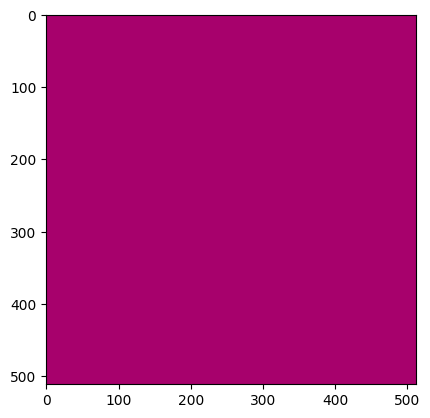

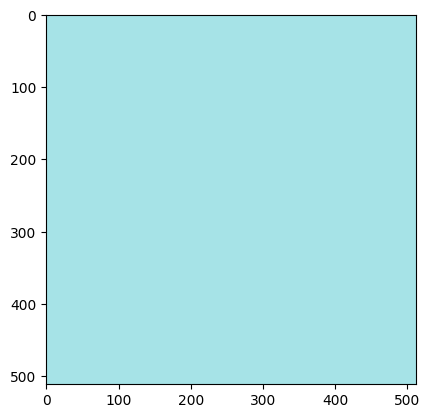

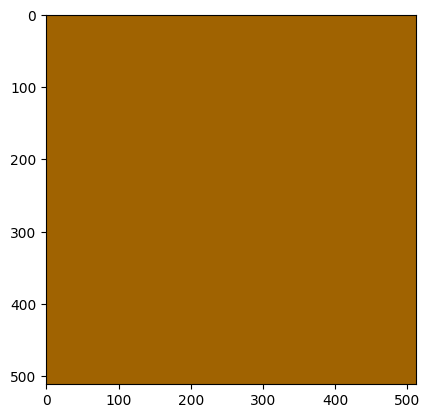

In [78]:
for i in range(3):
    plt.imshow(Image.fromarray(different_ims[i].permute(1, 2, 0).numpy().astype("uint8")))
    plt.show()

Cool, works! So let's test `display_images`

In [86]:
def unmk_img(t):
    '''Format image so it can pass through `mk_img`'''
    t = t.float() / 255  
    t = 2*(t-0.5)
    return t

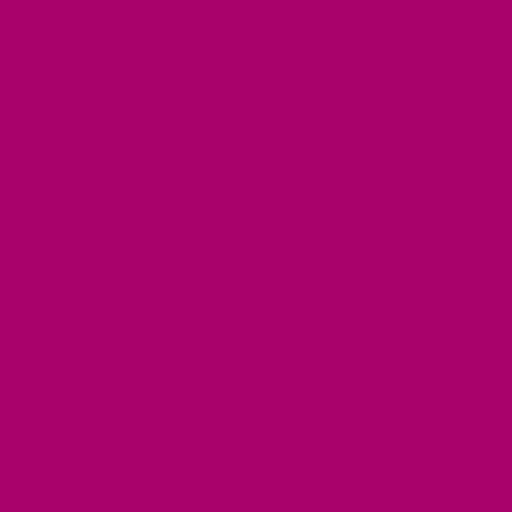

In [88]:
mk_img(unmk_img(different_ims[0]))

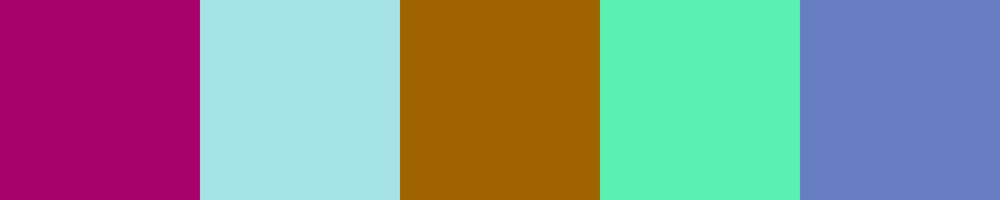

In [90]:
display_images(list(map(unmk_img, different_ims)), grid=True, cols=5)

Okay, so:
- `display_images` works (ie does not always show first image)
- images are numerically different for each step
- images **look** identical
- first image is correct

This implies the images change very little from step to step.
Let's run al 70 steps and verify.

In [91]:
mk_samples([prompt], [negative_prompt], cbs=[save_image_cb], cbs_init=[clear_images_cb])

Images cleared


/tmp/ipykernel_158/3603111561.py:13: FutureWarning: Accessing config attribute `in_channels` directly via 'UNet2DConditionModel' object attribute is deprecated. Please access 'in_channels' over 'UNet2DConditionModel's config object instead, e.g. 'unet.config.in_channels'.
  latents = torch.randn((bs, unet.in_channels, height//8, width//8))


  0%|          | 0/70 [00:00<?, ?it/s]

tensor([[[[nan, nan, nan,  ..., nan, nan, nan],
          [nan, nan, nan,  ..., nan, nan, nan],
          [nan, nan, nan,  ..., nan, nan, nan],
          ...,
          [nan, nan, nan,  ..., nan, nan, nan],
          [nan, nan, nan,  ..., nan, nan, nan],
          [nan, nan, nan,  ..., nan, nan, nan]],

         [[nan, nan, nan,  ..., nan, nan, nan],
          [nan, nan, nan,  ..., nan, nan, nan],
          [nan, nan, nan,  ..., nan, nan, nan],
          ...,
          [nan, nan, nan,  ..., nan, nan, nan],
          [nan, nan, nan,  ..., nan, nan, nan],
          [nan, nan, nan,  ..., nan, nan, nan]],

         [[nan, nan, nan,  ..., nan, nan, nan],
          [nan, nan, nan,  ..., nan, nan, nan],
          [nan, nan, nan,  ..., nan, nan, nan],
          ...,
          [nan, nan, nan,  ..., nan, nan, nan],
          [nan, nan, nan,  ..., nan, nan, nan],
          [nan, nan, nan,  ..., nan, nan, nan]]]], device='cuda:0', dtype=torch.float16)

/tmp/ipykernel_158/451487962.py:6: RuntimeWarning: invalid value encountered in cast
  return Image.fromarray((image*255).round().astype("uint8"))


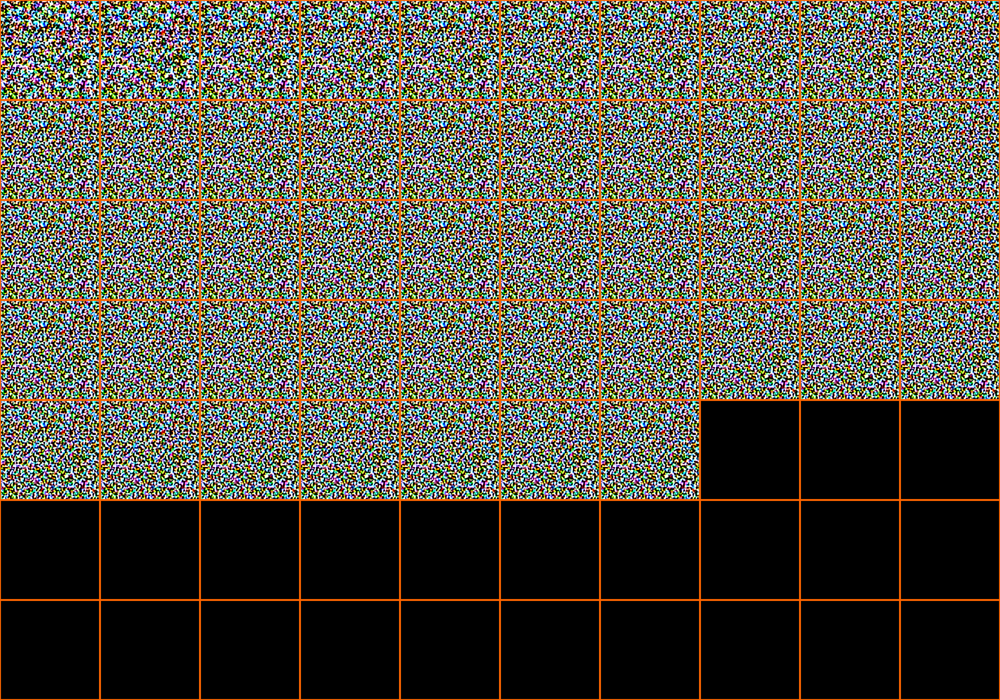

In [93]:
display_images(images, grid=True, cols=10, border=True)

In [95]:
for i in range(45,50): print(images[46]

tensor([[[-0.07, -0.11, -0.14,  ...,  0.02, -0.01, -0.01],
         [-0.08, -0.18, -0.25,  ...,  0.04, -0.03, -0.03],
         [-0.09, -0.22, -0.31,  ...,  0.08,  0.01,  0.00],
         ...,
         [ 0.10,  0.08, -0.02,  ..., -0.48, -0.21, -0.10],
         [ 0.07,  0.06, -0.02,  ..., -0.40, -0.21, -0.07],
         [ 0.06,  0.03, -0.02,  ..., -0.25, -0.10, -0.05]],

        [[ 0.08,  0.10,  0.12,  ..., -0.07, -0.11, -0.10],
         [ 0.12,  0.15,  0.14,  ..., -0.12, -0.15, -0.14],
         [ 0.16,  0.20,  0.19,  ..., -0.15, -0.17, -0.14],
         ...,
         [ 0.47,  0.65,  0.73,  ..., -0.74, -0.54, -0.29],
         [ 0.33,  0.47,  0.52,  ..., -0.63, -0.45, -0.24],
         [ 0.17,  0.25,  0.28,  ..., -0.41, -0.29, -0.18]],

        [[ 0.12,  0.18,  0.26,  ..., -0.04, -0.09, -0.08],
         [ 0.20,  0.32,  0.43,  ..., -0.01, -0.08, -0.09],
         [ 0.29,  0.44,  0.58,  ...,  0.02, -0.05, -0.06],
         ...,
         [ 0.23,  0.35,  0.34,  ..., -0.68, -0.48, -0.33],
         [

In [ ]:
mk_samples([prompt], cbs=[save_image_cb], cbs_init=[clear_images_cb])